In [6]:
import argparse
import csv
import os
import numpy as np
from typing import Any, Dict, Union, cast
from torchgeo.datamodules import ChesapeakeICLRDataModule
from torchgeo.trainers import SemanticSegmentationTask
from torchmetrics import MetricCollection
from torchmetrics.classification import BinaryAccuracy, BinaryJaccardIndex, MulticlassAccuracy, MulticlassJaccardIndex

import pytorch_lightning as pl
import torch

import matplotlib.pyplot as plt
from PIL import Image

### Take a look at the syn1 image/mask/synthetic images in our dataset

In [7]:
def colorize(image):
    size = image.shape
    color_image = torch.ByteTensor(3, size[0], size[1]).fill_(0)
    cmap = np.array([(0, 0, 0), (185, 224, 255), (40, 84, 48), (164, 190, 123), (229, 217, 182), (235, 100, 64), (119, 67, 219)],
                        dtype=np.uint8)
    cmap = torch.from_numpy(cmap)

    for label in range(0, len(cmap)):
        mask = (label == image).cpu()
        color_image[0][mask] = cmap[label][0]
        color_image[1][mask] = cmap[label][1]
        color_image[2][mask] = cmap[label][2]

    return color_image

In [8]:
def save_png(path, name):
    img = Image.open(path)
    img = Image.fromarray(np.array(img)[:,:,:3])
    img.save(name)
    return img

def show_dataset(name):
    real_path = "../data_chesapeakeiclr/md_1m_2013_extended-debuffered-train_tiles/"+name+'_naip-new.tif'
    mask_path = "../data_chesapeakeiclr/md_1m_2013_extended-debuffered-train_tiles/"+name+'_lc.tif'
    syn1_path = "../data_chesapeakeiclr/md_1m_2013_extended-debuffered-train_tiles/"+name+'_syn_lambda_6_0.tif'
    syn2_path = "../data_chesapeakeiclr/md_1m_2013_extended-debuffered-train_tiles/"+name+'_syn_lambda_6_1.tif'
    syn3_path = "../data_chesapeakeiclr/md_1m_2013_extended-debuffered-train_tiles/"+name+'_syn_lambda_6_2.tif'
    
    real = save_png(real_path, name+'_real.png')
    
    mask = Image.open(mask_path)
    mask = torch.from_numpy(np.array(mask))
    mask = colorize(mask).permute((1,2,0))
    mask = Image.fromarray(mask.numpy())
    mask.save(name+"_mask.png")
    
    syn1 = save_png(syn1_path, name+'_syn1.png')
    syn2 = save_png(syn2_path, name+'_syn2.png')
    syn3 = save_png(syn3_path, name+'_syn3.png')
    
    fig, ax = plt.subplots(1,5, figsize=((50, 20)))
    ax[0].imshow(real)
    ax[1].imshow(mask)
    ax[2].imshow(syn1)
    ax[3].imshow(syn2)
    ax[4].imshow(syn3)
    
    return real, mask, syn1, syn2, syn3

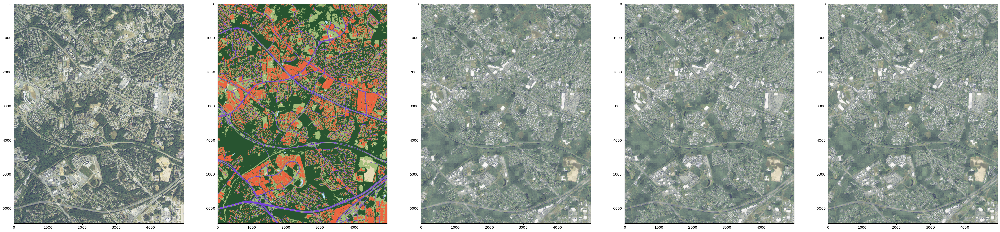

In [12]:
name = "m_3807609_ne_18_1"
_,_,_,_,_ = show_dataset(name)

### Downstream segmentation results

In [14]:
datamodule = ChesapeakeICLRDataModule(
    root="../data_chesapeakeiclr",
    num_workers=0,
    batch_size=1,
    class_set=7,
    train_splits=["md-train"],
    val_splits=["md-val"],
    test_splits=["md-test"],
    mix_rate=0.0,
    diversity=8,
    patches_per_tile=1
)
datamodule.setup()
test_dataloader = datamodule.test_dataloader()

In [15]:
def get_pred_image(model, batch, device):
    x = batch["image"].to(device)
    if "mask" in batch:
        y = batch["mask"].to(device)
    with torch.inference_mode():
        y_pred = model(x)
    return y_pred[0]

In [16]:
def visualize(model_lists, n_models, test_dataloader, start, num):
    n = 0
    images, masks = [], []
    preds = []
    for i in range(n_models):
        preds.append([])
    for batch in test_dataloader:
        if n < start: 
            n+=1
            continue
        if n == start+num: break
        images.append(batch["image"][0])
        masks.append(batch["mask"][0])
        for i in range(n_models):
            preds[i].append(get_pred_image(model_lists[i], batch, 'cpu'))
        n+=1
    
    fig, ax = plt.subplots(num, n_models+2, figsize=((n_models+2)*10, num*10))
    for i in range(num):
        ax[i,0].imshow(images[i].permute((1,2,0)))
        ax[i,1].imshow(colorize(masks[i]).permute((1,2,0)))
        for j in range(n_models):
            ax[i,j+2].imshow(colorize(torch.argmax(preds[j][i], dim=0)).permute((1,2,0)))

#### Image, Mask, real, Syn100, Syn200, Syn300

In [28]:
all_real = SemanticSegmentationTask.load_from_checkpoint("results/all_real/epoch=17-step=11250.ckpt")
syn100 = SemanticSegmentationTask.load_from_checkpoint("results/syn100/epoch=1-step=1250.ckpt")
syn200 = SemanticSegmentationTask.load_from_checkpoint("results/syn200/epoch=0-step=1250.ckpt")
syn300 = SemanticSegmentationTask.load_from_checkpoint("results/syn300/epoch=2-step=5625.ckpt") 

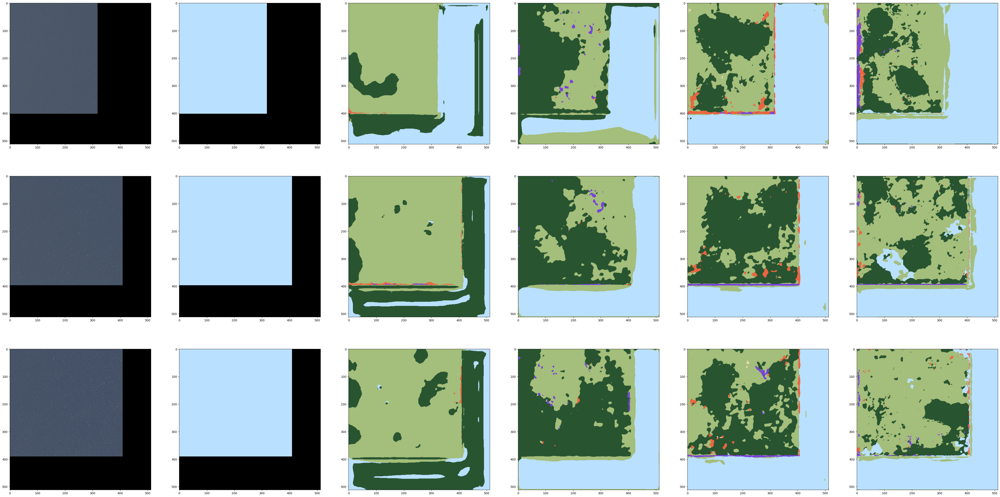

In [20]:
model_lists = [all_real, syn100, syn200, syn300]
visualize(model_lists, len(model_lists), test_dataloader, 0, 3)

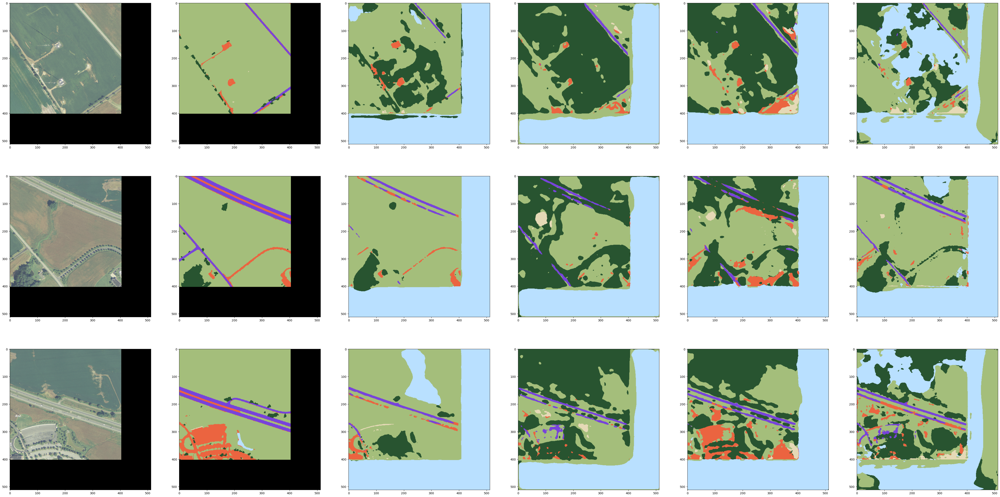

In [21]:
model_lists = [all_real, syn100, syn200, syn300]
visualize(model_lists, len(model_lists), test_dataloader, 500, 3)

#### Image, Mask, real, lambda4, lambda6, lambda10

In [23]:
# lambda0 = SemanticSegmentationTask.load_from_checkpoint("results/lambda0/epoch=15-step=10000.ckpt") 
# lambda2 = SemanticSegmentationTask.load_from_checkpoint("results/lambda2/epoch=7-step=5000.ckpt") 
lambda4 = SemanticSegmentationTask.load_from_checkpoint("results/lambda4/epoch=11-step=7500.ckpt")
lambda10 = SemanticSegmentationTask.load_from_checkpoint("results/lambda10/epoch=10-step=6875.ckpt")

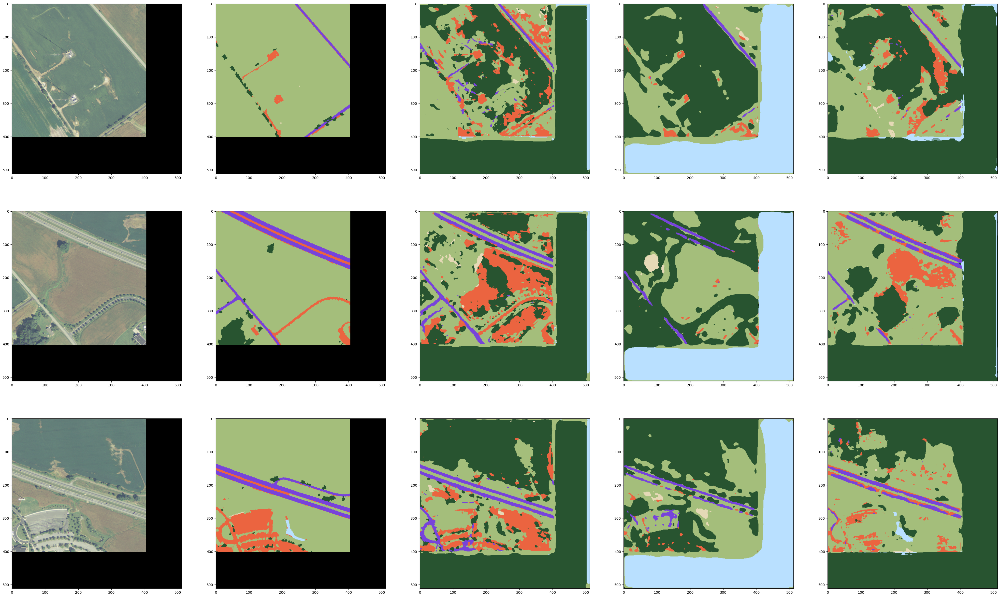

In [30]:
model_lists = [lambda4, syn100, lambda10]
visualize(model_lists, len(model_lists), test_dataloader, 500, 3)

#### Image, Mask, real, Syn50, Syn100

In [31]:
syn50 = SemanticSegmentationTask.load_from_checkpoint("results/syn50/epoch=30-step=19375.ckpt")

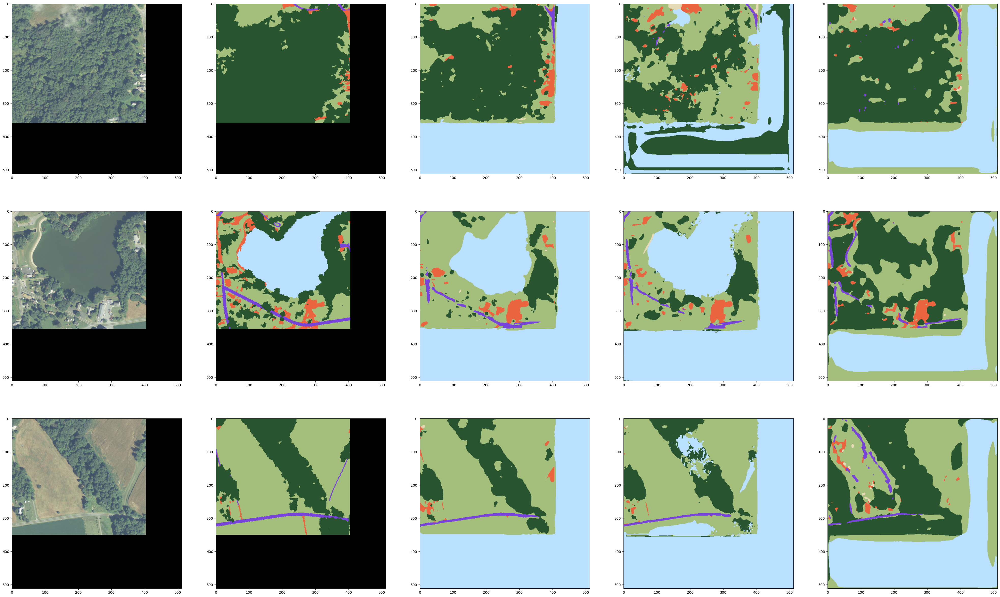

In [37]:
model_lists = [all_real, syn50, syn100]
visualize(model_lists, len(model_lists), test_dataloader, 450, 3)

#### Image, Mask, Real_channel3, Syn100_channel3, Syn100_channel4, Real_channel4

In [38]:
datamodule4 = ChesapeakeICLRDataModule(
    root="../data_chesapeakeiclr",
    num_workers=0,
    batch_size=1,
    class_set=7,
    train_splits=["md-train"],
    val_splits=["md-val"],
    test_splits=["md-test"],
    mix_rate=0.0,
    diversity=8,
    channels=4
)
datamodule4.setup()
test_dataloader4 = datamodule4.test_dataloader()

In [71]:
def visualize3and4(model3_lists, n_model3s, test_dataloader, model4_lists, n_model4s, test_dataloader4, start, num):
    n = 0
    images, masks = [], []
    preds = []
    for i in range(n_model3s+n_model4s):
        preds.append([])
        
    for batch in test_dataloader:
        if n < start: 
            n+=1
            continue
        if n == start+num: break
        images.append(batch["image"][0])
        masks.append(batch["mask"][0])
        for i in range(n_model3s):
            preds[i].append(get_pred_image(model3_lists[i], batch, 'cpu'))
        n+=1
         
    n=0
    for batch in test_dataloader4:
        if n < start: 
            n+=1
            continue
        if n == start+num: break
        for i in range(n_model4s):
            pred = get_pred_image(model4_lists[i], batch, 'cpu')
            preds[i+n_model3s].append(get_pred_image(model4_lists[i], batch, 'cpu'))
        n+=1
    
    
    fig, ax = plt.subplots(num, (n_model3s+n_model4s+2), figsize=((n_model3s+n_model4s+2)*10, num*10))
    for i in range(num):
        ax[i,0].imshow(images[i].permute((1,2,0)))
        ax[i,1].imshow(colorize(masks[i]).permute((1,2,0)))
        for j in range((n_model3s+n_model4s)):
            ax[i,j+2].imshow(colorize(torch.argmax(preds[j][i], dim=0)).permute((1,2,0)))
    return images, masks, preds

In [40]:
syn100_4 = SemanticSegmentationTask.load_from_checkpoint("results/lmy_4channel_full/epoch=17-step=576.ckpt")
real_4 = SemanticSegmentationTask.load_from_checkpoint("results/all_real_c4/epoch=25-step=16250.ckpt")

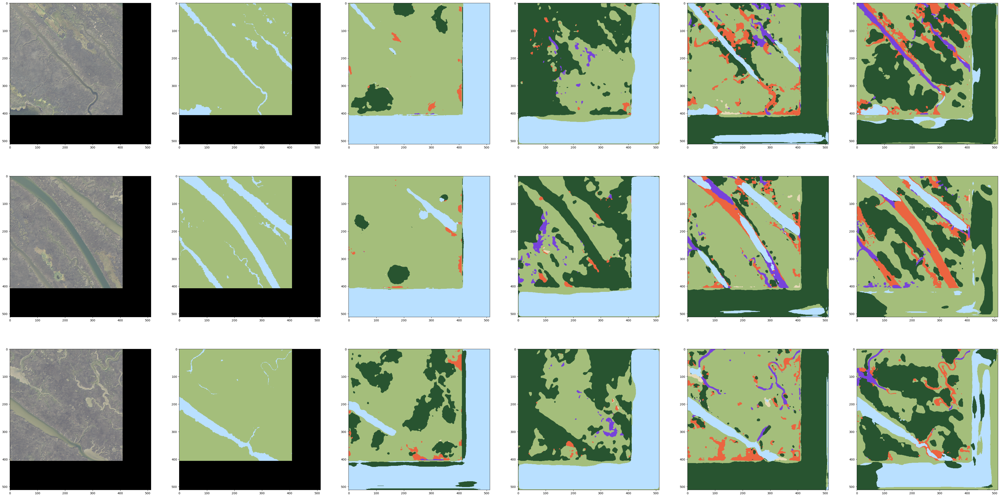

In [76]:
model3_lists = [all_real, syn100]
model4_lists = [syn100_4, real_4]
images, masks, preds = visualize3and4(model3_lists, len(model3_lists), test_dataloader, model4_lists, len(model4_lists), test_dataloader4, 280, 3)